# Smillie2019 (Smillie2019_human_IBD) 
# Cell type annotation

In [1]:
# load required modules
import scanpy as sc
import besca as bc
import pandas as pd
import numpy as np
import os
import pkg_resources

#import numpy as np
#from matplotlib import pyplot
#import sys

#setup document
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80)  # low dpi (dots per inch) yields small inline figures
sc.logging.print_versions()

./.conda/envs/besca_test/lib/python3.6/site-packages/scanpy/api/__init__.py:6: FutureWarning: 

In a future version of Scanpy, `scanpy.api` will be removed.
Simply use `import scanpy as sc` and `import scanpy.external as sce` instead.

  FutureWarning,


scanpy==1.4.5.post2 anndata==0.7.1 umap==0.3.10 numpy==1.17.5 scipy==1.4.1 pandas==0.24.1 scikit-learn==0.22.1 statsmodels==0.11.0 python-igraph==0.8.2 louvain==0.6.1


In [2]:
# define filepath (this is the folder that contains "raw" and "analyzed")
root_path = os.getcwd()

# input: results from standard workflow
analysis_name = 'standard_workflow_besca2_0'
results_folder = os.path.join(root_path, 'analyzed', analysis_name)
input_data = os.path.join(results_folder, analysis_name + '.h5ad') # specify a .h5ad file for storing the results

# define output directories
outdir_data = results_folder
outdir_figures = os.path.join(results_folder, 'figures')
outdir_results = os.path.join(results_folder, 'results')
sc.settings.figdir = os.path.join(outdir_figures)

os.makedirs(outdir_data, exist_ok=True)
os.makedirs(outdir_figures, exist_ok=True)
os.makedirs(outdir_results, exist_ok=True)

In [3]:
#reload our data from previously written out AnnData object
adata = sc.read(input_data)

In [4]:
adata

AnnData object with n_obs × n_vars = 149732 × 2196 
    obs: 'CELL', 'Cluster', 'Health', 'Location', 'Subject', 'celltype_highlevel', 'nGene', 'nUMI', 'original_name', 'percent_mito', 'n_counts', 'n_genes', 'batch', 'leiden'
    var: 'ENSEMBL', 'SYMBOL', 'n_cells', 'total_counts', 'frac_reads'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'

In [5]:
adata.obs.head()

,CELL,Cluster,Health,Location,Subject,celltype_highlevel,nGene,nUMI,original_name,percent_mito,n_counts,n_genes,batch,leiden
N7.EpiA.AAGCAAGAGTCAAC-Epi,N7.EpiA.AAGCAAGAGTCAAC-Epi,Cycling TA,Non-inflamed,Epi,N7,Epi,1507,7428,N7.EpiA.AAGCAAGAGTCAAC,0.057351,7428.0,1507,N7,8
N7.EpiA.ACGAGGGAGCTGAT-Epi,N7.EpiA.ACGAGGGAGCTGAT-Epi,Enterocyte Progenitors,Non-inflamed,Epi,N7,Epi,828,2877,N7.EpiA.ACGAGGGAGCTGAT,0.009037,2877.0,828,N7,0
N7.EpiA.ACGTTTACTGGTAC-Epi,N7.EpiA.ACGTTTACTGGTAC-Epi,Immature Enterocytes 2,Non-inflamed,Epi,N7,Epi,2318,15332,N7.EpiA.ACGTTTACTGGTAC,0.133707,15332.0,2318,N7,7
N7.EpiA.AGAGAATGGTCATG-Epi,N7.EpiA.AGAGAATGGTCATG-Epi,Enterocyte Progenitors,Non-inflamed,Epi,N7,Epi,884,3498,N7.EpiA.AGAGAATGGTCATG,0.002001,3498.0,884,N7,7
N7.EpiA.AGAGCGGAGTATGC-Epi,N7.EpiA.AGAGCGGAGTATGC-Epi,TA 1,Non-inflamed,Epi,N7,Epi,858,3261,N7.EpiA.AGAGCGGAGTATGC,0.003067,3261.0,858,N7,0


In [6]:
%matplotlib inline  
sc.settings.set_figure_params(dpi=90)

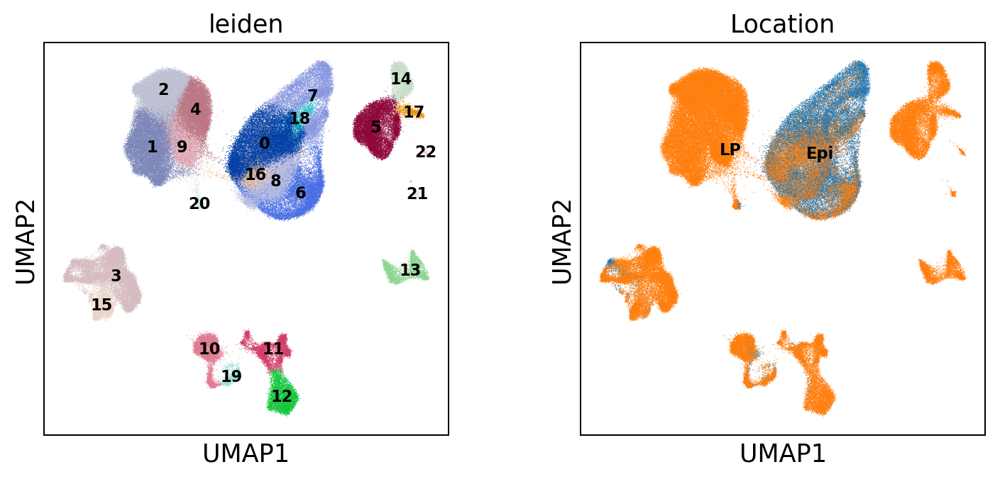

In [7]:
sc.pl.umap(adata, color=['leiden', 'Location'], legend_loc='on data', legend_fontsize=9)

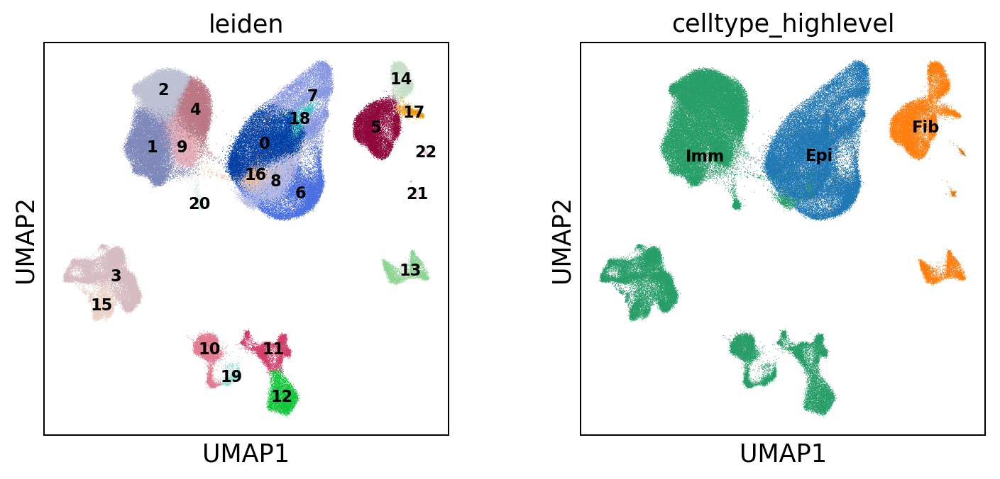

In [8]:
sc.pl.umap(adata, color=['leiden', 'celltype_highlevel'], legend_loc='on data', legend_fontsize=9)

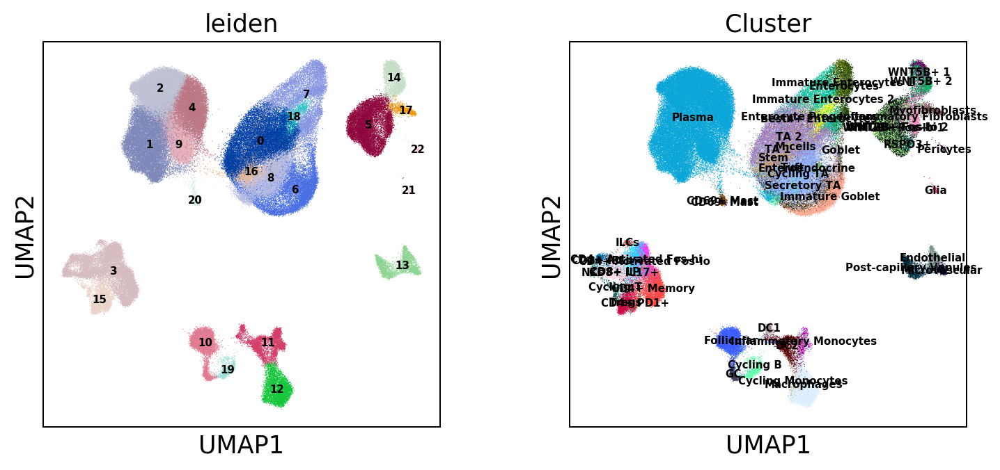

In [9]:
sc.pl.umap(adata, color=['leiden', 'Cluster'], legend_loc='on data', legend_fontsize=6)

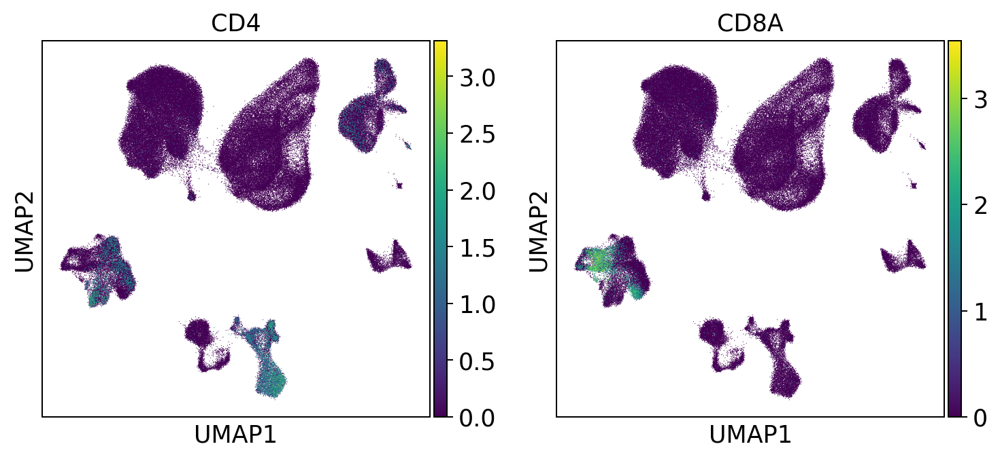

In [10]:
sc.pl.umap(adata, color=['CD4', 'CD8A'])

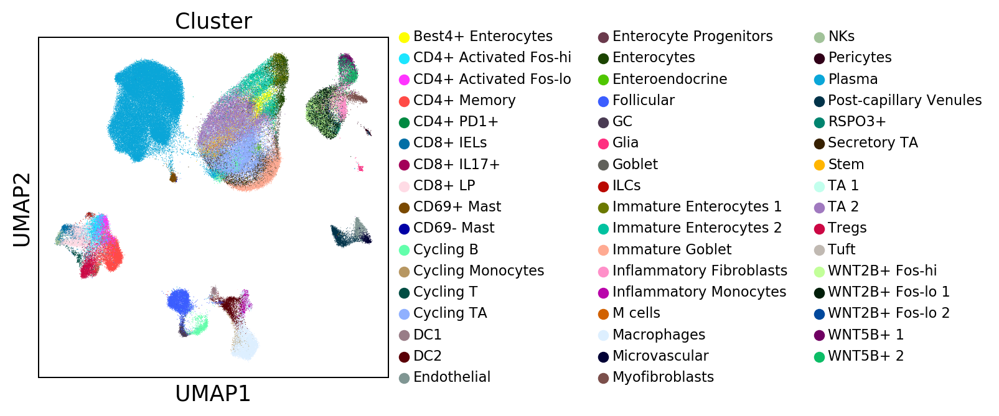

In [11]:
sc.pl.umap(adata, color=['Cluster'], legend_fontsize=9)

In [12]:
# Load GMT file and calculate signature scores
gmt_file_IMM=pkg_resources.resource_filename('besca', 'datasets/genesets/HumanCD45p_scseqCMs6.gmt')
gmt_file_anno=pkg_resources.resource_filename('besca', 'datasets/genesets/CellNames_scseqCMs6_sigs.gmt')

adata_IMM_scores = adata.copy()
adata_anno_scores = adata.copy()

bc.tl.sig.combined_signature_score(adata_IMM_scores, gmt_file_IMM)
bc.tl.sig.combined_signature_score(adata_anno_scores, gmt_file_anno)

computing score 'score_HumanCD45p_scseqCMs6_ActB_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_ActB_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_HumanCD45p_scseqCMs6_Activation_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_Activation_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_HumanCD45p_scseqCMs6_Basophil_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_Basophil_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_HumanCD45p_scseqCMs6_Bcells_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_Bcells_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_HumanCD45p_scseqCMs6_CCG1S_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_CCG1S_scanpyUP', score of gene set (adata.obs) (0:00:03)
computing score 'score_HumanCD45p_scseqCMs6_CCG2M_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_CCG2M_scanpyUP', score of g

    finished: added
    'score_HumanCD45p_scseqCMs6_MyeloSubtype_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_HumanCD45p_scseqCMs6_NKT_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_NKT_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_HumanCD45p_scseqCMs6_NKcells_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_NKcells_scanpyUP', score of gene set (adata.obs) (0:00:03)
computing score 'score_HumanCD45p_scseqCMs6_NKcyt_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_NKcyt_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_HumanCD45p_scseqCMs6_NKnai_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_NKnai_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_HumanCD45p_scseqCMs6_Naive_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_Naive_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_HumanCD45p_scseq

    finished: added
    'score_HumanCD45p_scseqCMs6_aDCs_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_HumanCD45p_scseqCMs6_allSteml_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_allSteml_scanpyUP', score of gene set (adata.obs) (0:00:03)
computing score 'score_HumanCD45p_scseqCMs6_cDC1_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_cDC1_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_HumanCD45p_scseqCMs6_cDC2_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_cDC2_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_HumanCD45p_scseqCMs6_cDCs_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_cDCs_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_HumanCD45p_scseqCMs6_epDCs_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_epDCs_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_HumanCD45p_scseqCMs6_gen

computing score 'score_CytotoxCD8Tcell_scanpyUP'
    finished: added
    'score_CytotoxCD8Tcell_scanpyUP', score of gene set (adata.obs) (0:00:03)
computing score 'score_ExhCD8Tcell_scanpyUP'
    finished: added
    'score_ExhCD8Tcell_scanpyUP', score of gene set (adata.obs) (0:00:03)
computing score 'score_cDC_CCR7_scanpyUP'
    finished: added
    'score_cDC_CCR7_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_Langerhans_scanpyUP'
    finished: added
    'score_Langerhans_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_Macrophage_MSR1_scanpyUP'
    finished: added
    'score_Macrophage_MSR1_scanpyUP', score of gene set (adata.obs) (0:00:03)
computing score 'score_Macrophage_CXCL9_scanpyUP'
    finished: added
    'score_Macrophage_CXCL9_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_Monocyte_scanpyUP'
    finished: added
    'score_Monocyte_scanpyUP', score of gene set (adata.obs) (0:00:03)
computing score

computing score 'score_IgGPlasma_scanpyUP'
    finished: added
    'score_IgGPlasma_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_IgMPlasma_scanpyUP'
    finished: added
    'score_IgMPlasma_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_ILC1_scanpyUP'
    finished: added
    'score_ILC1_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_ILC3_scanpyUP'
    finished: added
    'score_ILC3_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_ActTcell_scanpyUP'
    finished: added
    'score_ActTcell_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_NaiTcell_scanpyUP'
    finished: added
    'score_NaiTcell_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_McellGut_scanpyUP'
    finished: added
    'score_McellGut_scanpyUP', score of gene set (adata.obs) (0:00:02)
computing score 'score_Mast_scanpyUP'
    finished: added
    'score_Mast_scanpyU

In [13]:
adata_anno_scores

AnnData object with n_obs × n_vars = 149732 × 2196 
    obs: 'CELL', 'Cluster', 'Health', 'Location', 'Subject', 'celltype_highlevel', 'nGene', 'nUMI', 'original_name', 'percent_mito', 'n_counts', 'n_genes', 'batch', 'leiden', 'score_Bcell_scanpy', 'score_Fibroblast_scanpy', 'score_Endothelial_scanpy', 'score_Epithelial_scanpy', 'score_Granulocyte_scanpy', 'score_MelMelanoma_scanpy', 'score_MemBcell_scanpy', 'score_Myeloid_scanpy', 'score_NKcell_scanpy', 'score_NaiBcell_scanpy', 'score_Neutrophil_scanpy', 'score_Plasma_scanpy', 'score_CD4Tcell_scanpy', 'score_CD8Tcell_scanpy', 'score_Tcell_scanpy', 'score_CD8Tcell_IL7Rmax_scanpy', 'score_CD4Tcell_IL7Rmax_scanpy', 'score_RegTcell_scanpy', 'score_cDC1_scanpy', 'score_cDC2_scanpy', 'score_cDC_scanpy', 'score_NClassMonocyte_scanpy', 'score_pDC_scanpy', 'score_Hematopoetic_scanpy', 'score_Blymphocyte_scanpy', 'score_CD56dimNK_scanpy', 'score_CD56brightNK_scanpy', 'score_NaiCD4Tcell_scanpy', 'score_NaiCD8Tcell_scanpy', 'score_ProlifCD8Tcell_

In [14]:
adata_IMM_scores

AnnData object with n_obs × n_vars = 149732 × 2196 
    obs: 'CELL', 'Cluster', 'Health', 'Location', 'Subject', 'celltype_highlevel', 'nGene', 'nUMI', 'original_name', 'percent_mito', 'n_counts', 'n_genes', 'batch', 'leiden', 'score_HumanCD45p_scseqCMs6_ActB_scanpy', 'score_HumanCD45p_scseqCMs6_Activation_scanpy', 'score_HumanCD45p_scseqCMs6_Basophil_scanpy', 'score_HumanCD45p_scseqCMs6_Bcells_scanpy', 'score_HumanCD45p_scseqCMs6_CCG1S_scanpy', 'score_HumanCD45p_scseqCMs6_CCG2M_scanpy', 'score_HumanCD45p_scseqCMs6_Cafs_scanpy', 'score_HumanCD45p_scseqCMs6_Cellcycle_scanpy', 'score_HumanCD45p_scseqCMs6_Checkpoint_scanpy', 'score_HumanCD45p_scseqCMs6_Cyto_scanpy', 'score_HumanCD45p_scseqCMs6_Cytotox_scanpy', 'score_HumanCD45p_scseqCMs6_DCR_scanpy', 'score_HumanCD45p_scseqCMs6_DCrec_scanpy', 'score_HumanCD45p_scseqCMs6_DCs_scanpy', 'score_HumanCD45p_scseqCMs6_Eff_scanpy', 'score_HumanCD45p_scseqCMs6_Endo_scanpy', 'score_HumanCD45p_scseqCMs6_Endot_scanpy', 'score_HumanCD45p_scseqCMs6_Endo

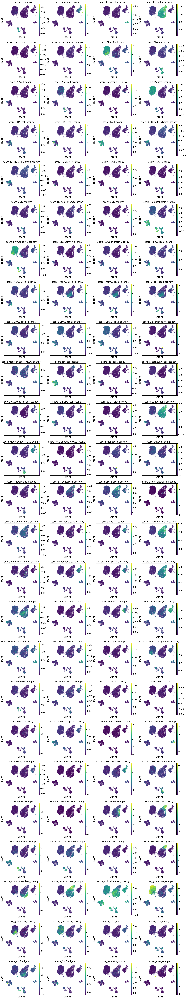

In [15]:
scores = [x for x in adata_anno_scores.obs.columns if 'scanpy' in x]
sc.pl.umap(adata_anno_scores, color=scores, color_map='viridis')

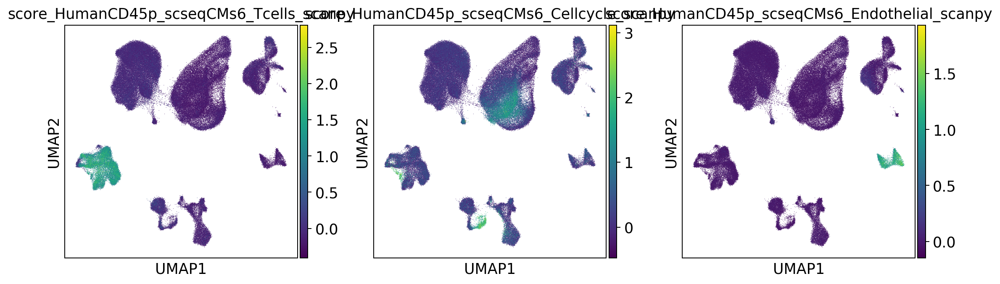

In [16]:
sc.pl.umap(adata_IMM_scores, color=['score_HumanCD45p_scseqCMs6_Tcells_scanpy',
                                     'score_HumanCD45p_scseqCMs6_Cellcycle_scanpy',
                                     'score_HumanCD45p_scseqCMs6_Endothelial_scanpy'], legend_loc='on data',legend_fontsize=6)

In [17]:
sorted(adata.obs.get('Cluster').unique(), key=str)

['Best4+ Enterocytes',
 'CD4+ Activated Fos-hi',
 'CD4+ Activated Fos-lo',
 'CD4+ Memory',
 'CD4+ PD1+',
 'CD69+ Mast',
 'CD69- Mast',
 'CD8+ IELs',
 'CD8+ IL17+',
 'CD8+ LP',
 'Cycling B',
 'Cycling Monocytes',
 'Cycling T',
 'Cycling TA',
 'DC1',
 'DC2',
 'Endothelial',
 'Enterocyte Progenitors',
 'Enterocytes',
 'Enteroendocrine',
 'Follicular',
 'GC',
 'Glia',
 'Goblet',
 'ILCs',
 'Immature Enterocytes 1',
 'Immature Enterocytes 2',
 'Immature Goblet',
 'Inflammatory Fibroblasts',
 'Inflammatory Monocytes',
 'M cells',
 'Macrophages',
 'Microvascular',
 'Myofibroblasts',
 'NKs',
 'Pericytes',
 'Plasma',
 'Post-capillary Venules',
 'RSPO3+',
 'Secretory TA',
 'Stem',
 'TA 1',
 'TA 2',
 'Tregs',
 'Tuft',
 'WNT2B+ Fos-hi',
 'WNT2B+ Fos-lo 1',
 'WNT2B+ Fos-lo 2',
 'WNT5B+ 1',
 'WNT5B+ 2']

In [18]:
#write down new cluster names (important order needs to be equivalent to above)
new_cluster_names = ['enterocyte', 'activated CD4-positive, alpha-beta T cell', 'activated CD4-positive, alpha-beta T cell', 
                     'CD4-positive, alpha-beta memory T cell', 'exhausted-like CD4-positive, alpha-beta T cell', 'mast cell', 
                     'mast cell', 'CD8-positive, alpha-beta T cell', 
                     'CD8-positive, alpha-beta cytokine secreting effector T cell', 'CD8-positive, alpha-beta T cell', 
                     'proliferating B cell', 'proliferating monocyte', 'proliferating T cell', 
                     'proliferating transit amplifying cell', 'CD141-positive myeloid dendritic cell', 
                     'CD1c-positive myeloid dendritic cell', 'endothelial cell', 'enterocyte progenitor', 'enterocyte', 
                     'enteroendocrine cell', 'follicular B cell', 'germinal center B cell', 'glial cell', 'goblet cell', 
                     'innate lymphoid cell', 'immature enterocyte', 'immature enterocyte', 'immature goblet cell', 
                     'inflammatory fibroblast', 'inflammatory monocyte', 'microfold cell', 'macrophage', 
                     'microvascular endothelial cell', 'myofibroblast cell', 'natural killer cell', 'pericyte cell', 
                     'plasma cell', 'HEV endothelial cell', 'fibroblast', 'transit amplifying cell', 'stem cell', 
                     'transit amplifying cell', 'transit amplifying cell', 'regulatory T cell', 'brush cell', 'fibroblast', 
                     'fibroblast', 'fibroblast', 'fibroblast', 'fibroblast']

    
bc.tl.annotate_cells_clustering(adata=adata, clustering_label='Cluster', new_annotation_label='dblabel', new_cluster_labels=new_cluster_names)

In [19]:
#write down new cluster names (important order needs to be equivalent to above)
new_cluster_names = ['epithelial cell', 'plasma cell', 'plasma cell', 'T cell or ILC', 'plasma cell', 'fibroblast',
                     'goblet cell', 'enterocyte', 'epithelial cell', 'plasma cell', 'B cell', 'myeloid leukocyte', 
                     'macrophage', 'endothelial cell', 'fibroblast', 'regulatory T cell', 'epithelial cell', 
                     'myofibroblast cell', 'enterocyte', 'B cell', 'mast cell', 'neural cell', 'pericyte cell']

    
bc.tl.annotate_cells_clustering(adata=adata, clustering_label='leiden', new_annotation_label='celltype', new_cluster_labels=new_cluster_names)

In [20]:
#write down new cluster names (important order needs to be equivalent to above)
new_cluster_names = ['0: epithelial cell', '1: plasma cell', '2: plasma cell', '3: T cell or ILC', '4: plasma cell', 
                     '5: fibroblast', '6: goblet cell', '7: enterocyte', '8: epithelial cell', '9: plasma cell', 
                     '10: B cell', '11: myeloid leukocyte', '12: macrophage', '13: endothelial cell', '14: fibroblast', 
                     '15: regulatory T cell', '16: epithelial cell', '17: myofibroblast cell', '18: enterocyte', 
                     '19: B cell', '20: mast cell', '21: neural cell', '22: pericyte cell']

    
bc.tl.annotate_cells_clustering(adata=adata, clustering_label='leiden', new_annotation_label='cluster_celltype', new_cluster_labels=new_cluster_names)

In [21]:
adata = bc.st.additional_labeling(adata, 'dblabel', 'dblabel', 'Curated celltype annotation.', 'Klas Hatje', outdir_data)

ranking genes


... storing 'dblabel' as categorical
... storing 'celltype' as categorical
... storing 'cluster_celltype' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:06:40)
rank genes per label calculated using method wilcoxon.
mapping of cells to  dblabel exported successfully to cell2labels.tsv
average.gct exported successfully to file
fract_pos.gct exported successfully to file
labelinfo.tsv successfully written out
./analyzed/standard_workflow_besca2_0/labelings/dblabel/WilxRank.gct written out
./analyzed/standard_workflow_besca2_0/labelings/dblabel/WilxRank.pvalues.gct written out
./analyzed/standard_workflow_besca2_0/labelings/dblabel/WilxRank.logFC.gct written out


In [22]:
adata = bc.st.additional_labeling(adata, 'celltype', 'celltype', 'Manual celltype annotation.', 'Klas Hatje', outdir_data)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:05:41)
rank genes per label calculated using method wilcoxon.
mapping of cells to  celltype exported successfully to cell2labels.tsv
average.gct exported successfully to file
fract_pos.gct exported successfully to file
labelinfo.tsv successfully written out
./analyzed/standard_workflow_besca2_0/labelings/celltype/WilxRank.gct written out
./analyzed/standard_workflow_besca2_0/labelings/celltype/WilxRank.pvalues.gct written out
./analyzed/standard_workflow_besca2_0/labelings/celltype/WilxRank.logFC.gct written out


In [23]:
adata = bc.st.additional_labeling(adata, 'celltype_highlevel', 'Smillie2019_celltype_highlevel', 'Coarse cell type annotation from authors [Smillie2019].', 'Smillie et al', outdir_data)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:05:12)
rank genes per label calculated using method wilcoxon.
mapping of cells to  celltype_highlevel exported successfully to cell2labels.tsv
average.gct exported successfully to file
fract_pos.gct exported successfully to file
labelinfo.tsv successfully written out
./analyzed/standard_workflow_besca2_0/labelings/Smillie2019_celltype_highlevel/WilxRank.gct written out
./analyzed/standard_workflow_besca2_0/labelings/Smillie2019_celltype_highlevel/WilxRank.pvalues.gct written out
./analyzed/standard_workflow_besca2_0/labelings/Smillie2019_celltype_highlevel/WilxRank.logFC.gct written out


In [24]:
adata = bc.st.additional_labeling(adata, 'Cluster', 'Smillie2019_Cluster', 'Cell type cluster annotation from authors [Smillie2019].', 'Smillie et al', outdir_data)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:07:09)
rank genes per label calculated using method wilcoxon.
mapping of cells to  Cluster exported successfully to cell2labels.tsv
average.gct exported successfully to file
fract_pos.gct exported successfully to file
labelinfo.tsv successfully written out
./analyzed/standard_workflow_besca2_0/labelings/Smillie2019_Cluster/WilxRank.gct written out
./analyzed/standard_workflow_besca2_0/labelings/Smillie2019_Cluster/WilxRank.pvalues.gct written out
./analyzed/standard_workflow_besca2_0/labelings/Smillie2019_Cluster/WilxRank.logFC.gct written out


In [25]:
adata.write(filename=os.path.join(outdir_data, 'Smillie2019_processed.h5ad'), )

# Compare to signature decision tree based annotation

In [26]:
gmt_file_anno=pkg_resources.resource_filename('besca', 'datasets/genesets/CellNames_scseqCMs6_sigs.gmt')

mymarkers  = bc.tl.sig.read_GMT_sign(gmt_file_anno,directed=False)
mymarkers = bc.tl.sig.filter_siggenes(adata, mymarkers) ### remove genes not present in dataset or empty signatures
mymarkers['Ubi'] = ['B2M','ACTB', 'GAPDH'] ### used for cutoff adjustment

In [27]:
configfile=pkg_resources.resource_filename('besca', 'datasets/genesets/CellNames_scseqCMs6_config.tsv')

sigconfig,levsk=bc.tl.sig.read_annotconfig(configfile)

# Fract_pos was exported by BESCA in the standard worflow
f=pd.read_csv(results_folder + "/labelings/leiden/fract_pos.gct",sep="\t",skiprows=2)
df=bc.tl.sig.score_mw(f,mymarkers)
myc=np.median(df.loc['Ubi',:]*0.5) ### Set a cutoff based on Ubi and scale with values from config file

# Cluster attribution based on cutoff
df=df.drop('Ubi')
sigscores={}
for mysig in list(df.index):
    sigscores[mysig]=bc.tl.sig.getset(df,mysig,sigconfig.loc[mysig,'Cutoff']*myc)
    #sigscores[mysig]=bc.tl.sig.getset(df,mysig,10)

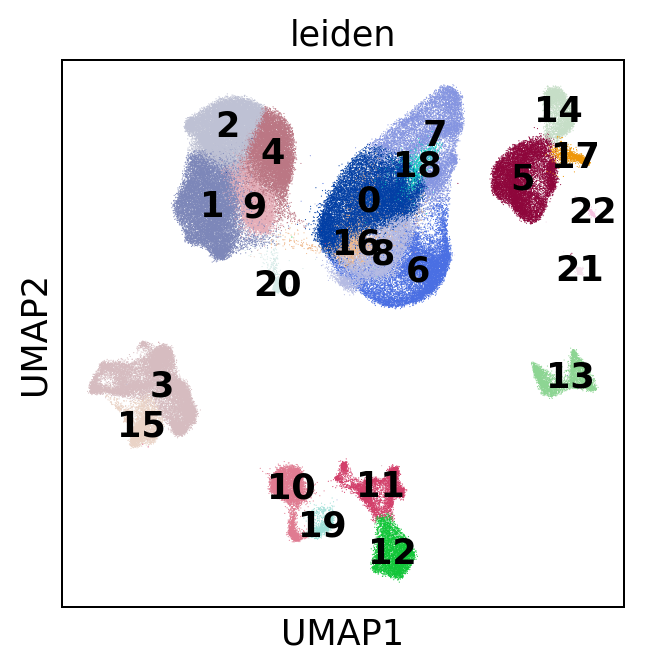

In [28]:
sc.pl.umap(adata, color=['leiden'], legend_loc='on data')

In [29]:
### Check here if your favorite cluster has the correct attribution
### Clusters will be attributed in the order specified in levsk
### To change the attribution order, change the rank in the configuration table
sigscores

{'Bcell': {'10', '19'},
 'Fibroblast': {'14', '17', '22', '5'},
 'Endothelial': {'13'},
 'Epithelial': {'0', '16', '18', '6', '7', '8'},
 'Granulocyte': set(),
 'MelMelanoma': set(),
 'MemBcell': {'1', '10', '15', '19', '2', '20', '4', '9'},
 'Myeloid': {'1', '10', '11', '12', '2', '4', '9'},
 'NKcell': {'3'},
 'NaiBcell': {'10', '19'},
 'Neutrophil': set(),
 'Plasma': {'1', '10', '19', '2', '20', '4', '9'},
 'CD4Tcell': {'11', '12', '14', '15', '20', '3'},
 'CD8Tcell': {'3'},
 'Tcell': {'15', '3'},
 'CD8Tcell_IL7Rmax': set(),
 'CD4Tcell_IL7Rmax': set(),
 'RegTcell': {'15'},
 'cDC1': {'11'},
 'cDC2': {'11'},
 'cDC': {'11'},
 'NClassMonocyte': set(),
 'pDC': set(),
 'Hematopoetic': {'1',
  '10',
  '11',
  '12',
  '15',
  '17',
  '19',
  '2',
  '20',
  '3',
  '4',
  '9'},
 'Blymphocyte': {'1', '10', '19', '2', '20', '4', '9'},
 'CD56dimNK': {'3'},
 'CD56brightNK': {'3'},
 'NaiCD4Tcell': {'3'},
 'NaiCD8Tcell': set(),
 'ProlifCD8Tcell': {'19', '8'},
 'ProlifCD4Tcell': {'19', '8'},
 'Prolif

In [30]:
cnames=bc.tl.sig.make_anno(df,sigscores,sigconfig,levsk)

In [31]:
cnames

,celltype0,celltype1,celltype2,celltype3
7,Epithelial,ImmatureEnterocyte,ImmatureEnterocyte,ImmatureEnterocyte
0,Epithelial,EnterocytePC,EnterocytePC,EnterocytePC
3,Hematopoetic,Tcell,CD8Tcell,CytotoxCD8Tcell
4,Hematopoetic,Blymphocyte,Plasma,Plasma
9,Hematopoetic,Blymphocyte,Plasma,Plasma
21,Neural,Neural,Neural,Neural
6,Epithelial,ImmatureGoblet,ImmatureGoblet,ImmatureGoblet
10,Hematopoetic,Blymphocyte,Bcell,MemBcell
14,Fibroblast,Fibroblast,Fibroblast,Fibroblast
11,Hematopoetic,Myeloid,cDC,cDC1


In [32]:
adata.obs['celltype0']=bc.tl.sig.add_anno(adata,cnames,'celltype0','leiden')
adata.obs['celltype1']=bc.tl.sig.add_anno(adata,cnames,'celltype1','leiden')
adata.obs['celltype2']=bc.tl.sig.add_anno(adata,cnames,'celltype2','leiden')
adata.obs['celltype3']=bc.tl.sig.add_anno(adata,cnames,'celltype3','leiden')

In [33]:
adata

AnnData object with n_obs × n_vars = 149732 × 2196 
    obs: 'CELL', 'Cluster', 'Health', 'Location', 'Subject', 'celltype_highlevel', 'nGene', 'nUMI', 'original_name', 'percent_mito', 'n_counts', 'n_genes', 'batch', 'leiden', 'dblabel', 'celltype', 'cluster_celltype', 'celltype0', 'celltype1', 'celltype2', 'celltype3'
    var: 'ENSEMBL', 'SYMBOL', 'n_cells', 'total_counts', 'frac_reads'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'Location_colors', 'celltype_highlevel_colors', 'Cluster_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'

... storing 'celltype0' as categorical
... storing 'celltype1' as categorical
... storing 'celltype2' as categorical
... storing 'celltype3' as categorical


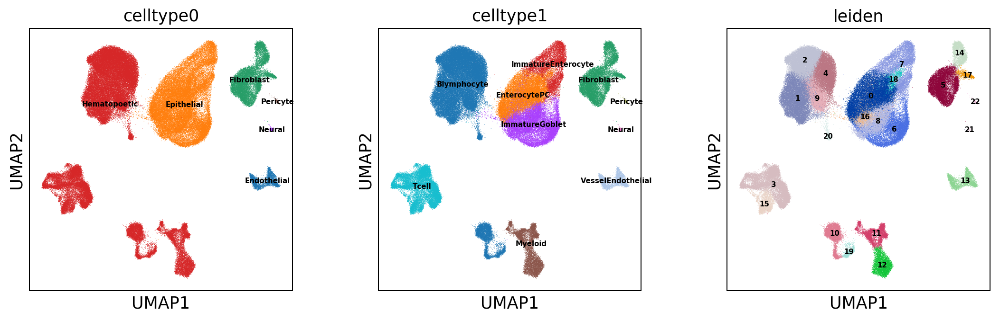

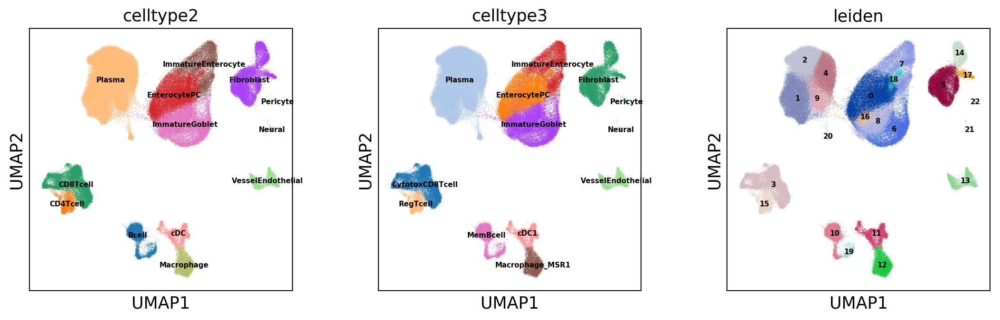

In [34]:
sc.pl.umap(adata, color=['celltype0','celltype1', 'leiden'], legend_loc='on data',legend_fontsize=6)
sc.pl.umap(adata, color=['celltype2','celltype3', 'leiden'], legend_loc='on data',legend_fontsize=6)

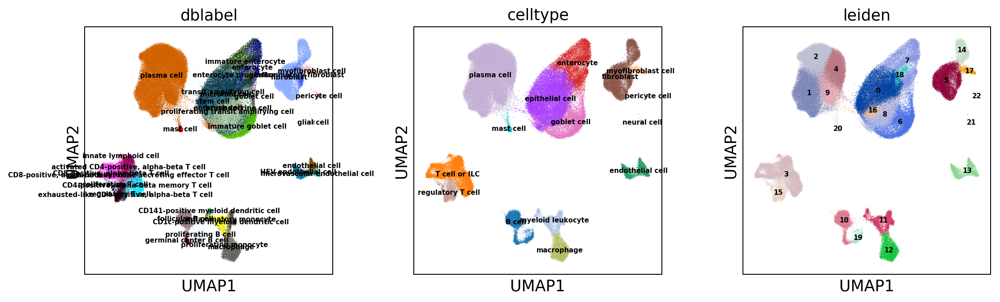

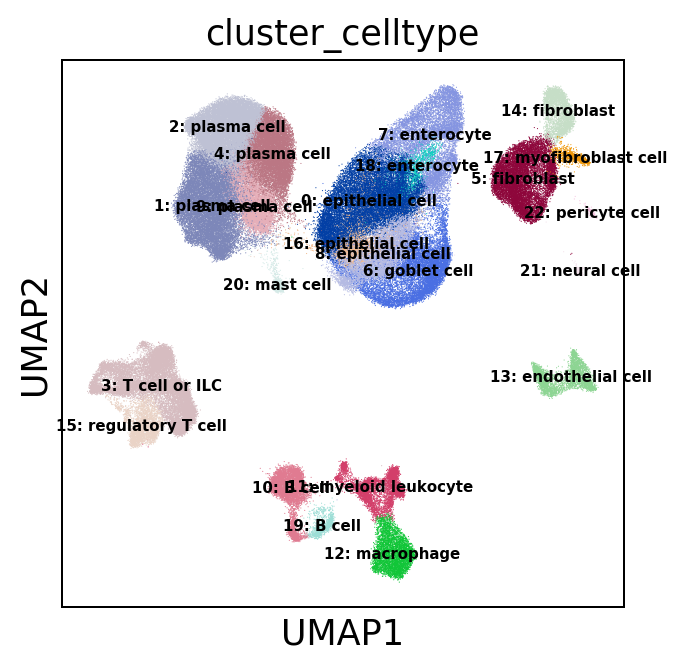

In [35]:
sc.pl.umap(adata, color=['dblabel','celltype', 'leiden'], legend_loc='on data',legend_fontsize=6)
sc.pl.umap(adata, color=['cluster_celltype'], legend_loc='on data',legend_fontsize=6)

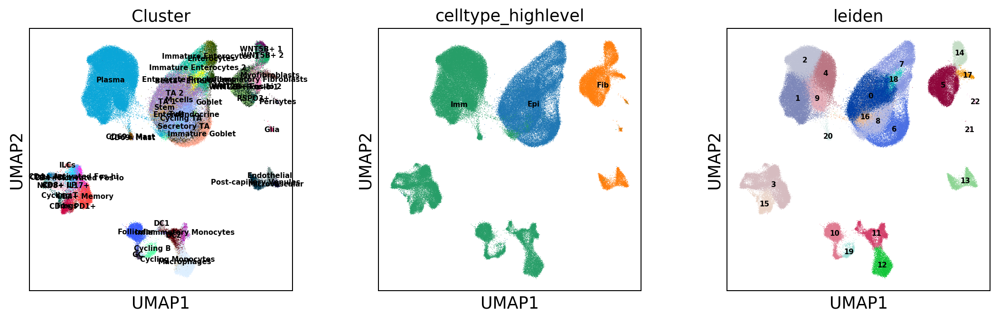

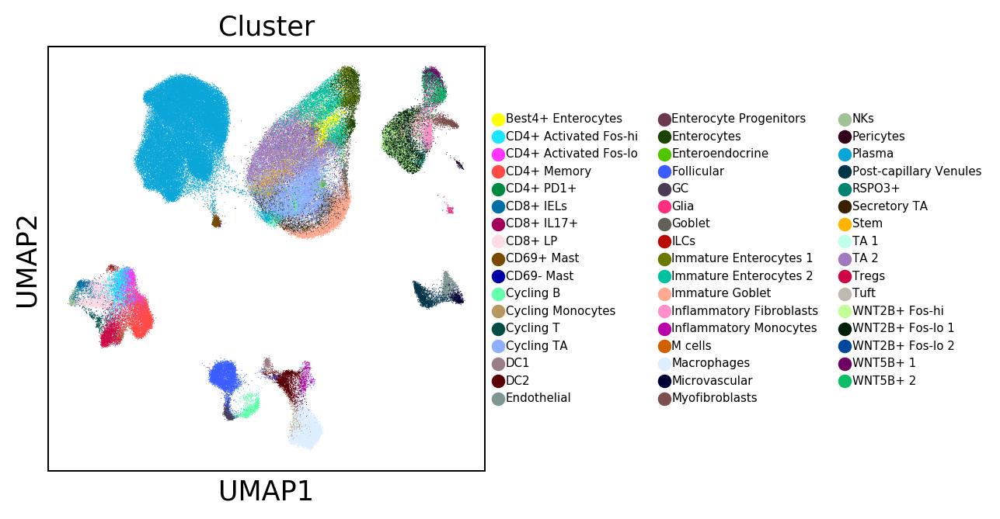

In [36]:
sc.pl.umap(adata, color=['Cluster','celltype_highlevel', 'leiden'], legend_loc='on data',legend_fontsize=6)
sc.pl.umap(adata, color=['Cluster'], legend_fontsize=6)